In [45]:
%load_ext autoreload
%autoreload 2

from pathlib import Path

import dotenv
import matplotlib.pyplot as plt
import scanpy as sc
import tensorflow as tf
import pandas as pd

from keras import callbacks
from keras.models import Model
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import minmax_scale

from isrobust_TFG.bio import get_reactome_adj, sync_gexp_adj
from isrobust_TFG.datasets import load_kang
from isrobust_TFG.utils import set_all_seeds
from isrobust_TFG.CI_VAE_CLASS import InformedVAE

project_path = Path(dotenv.find_dotenv()).parent
results_path = project_path.joinpath("results")
results_path.mkdir(exist_ok=True, parents=True)
data_path = project_path.joinpath("data")
data_path.mkdir(exist_ok=True, parents=True)
figs_path = results_path.joinpath("figs")
figs_path.mkdir(exist_ok=True, parents=True)
tables_path = results_path.joinpath("tables")
tables_path.mkdir(exist_ok=True, parents=True)

set_all_seeds(seed=42)

tf.config.experimental.enable_op_determinism()

sc.set_figure_params(dpi=300, color_map="inferno")
sc.settings.verbosity = 1
sc.logging.print_header()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
scanpy==1.9.8 anndata==0.10.9 umap==0.5.6 numpy==1.26.4 scipy==1.10.1 pandas==2.2.3 scikit-learn==1.5.2 statsmodels==0.14.4 igraph==0.10.8 pynndescent==0.5.13


In [46]:
adata = load_kang(data_folder=data_path, normalize=True, n_genes=4000)

/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/sfernandez/TFG/robustness_informed_TFG/isrobust_TFG/datasets.py:18: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs["label"] = adata.obs["label"].replace(


In [47]:
x_trans = adata.to_df()

In [48]:
reactome = get_reactome_adj()
reactome.head()

geneset,REACTOME_2_LTR_CIRCLE_FORMATION,REACTOME_ABACAVIR_METABOLISM,REACTOME_ABACAVIR_TRANSMEMBRANE_TRANSPORT,REACTOME_ABACAVIR_TRANSPORT_AND_METABOLISM,REACTOME_ABC_FAMILY_PROTEINS_MEDIATED_TRANSPORT,REACTOME_ABC_TRANSPORTERS_IN_LIPID_HOMEOSTASIS,REACTOME_ABC_TRANSPORTER_DISORDERS,REACTOME_ABERRANT_REGULATION_OF_MITOTIC_EXIT_IN_CANCER_DUE_TO_RB1_DEFECTS,REACTOME_ABERRANT_REGULATION_OF_MITOTIC_G1_S_TRANSITION_IN_CANCER_DUE_TO_RB1_DEFECTS,REACTOME_ABORTIVE_ELONGATION_OF_HIV_1_TRANSCRIPT_IN_THE_ABSENCE_OF_TAT,...,REACTOME_WNT5A_DEPENDENT_INTERNALIZATION_OF_FZD2_FZD5_AND_ROR2,REACTOME_WNT5A_DEPENDENT_INTERNALIZATION_OF_FZD4,REACTOME_WNT_LIGAND_BIOGENESIS_AND_TRAFFICKING,REACTOME_WNT_MEDIATED_ACTIVATION_OF_DVL,REACTOME_XENOBIOTICS,REACTOME_YAP1_AND_WWTR1_TAZ_STIMULATED_GENE_EXPRESSION,REACTOME_ZBP1_DAI_MEDIATED_INDUCTION_OF_TYPE_I_IFNS,REACTOME_ZINC_EFFLUX_AND_COMPARTMENTALIZATION_BY_THE_SLC30_FAMILY,REACTOME_ZINC_INFLUX_INTO_CELLS_BY_THE_SLC39_GENE_FAMILY,REACTOME_ZINC_TRANSPORTERS
genesymbol,,,,,,,,,,,,,,,,,,,,,
A1BG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A1CF,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A2M,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
A4GNT,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAAS,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [49]:
x_trans, reactome = sync_gexp_adj(x_trans, reactome)

In [50]:
x_trans.shape, reactome.shape

((24673, 2160), (2160, 1615))

In [51]:
obs = adata.obs.copy()

x_train, x_test = train_test_split(
    x_trans.apply(minmax_scale),
    test_size=0.33,
    stratify=obs["cell_type"],
    random_state=42,
)
x_train = x_train.astype("float32")
x_test = x_test.astype("float32")

In [52]:
x_train.shape, reactome.shape

((16530, 2160), (2160, 1615))

In [53]:
model = InformedVAE(
    adjacency_matrices=reactome, adjacency_names="reactome", adjacency_activation="tanh",seed=42
)

model._build_vae()

batch_size = 32

callback = callbacks.EarlyStopping(
    monitor="val_loss",
    min_delta=1e-1,
    patience=100,
    verbose=0,
)

history = model.fit(
    x_train,
    x_train,
    shuffle=True,
    verbose=1,
    epochs=100,
    batch_size=batch_size,
    callbacks=[callback],
    validation_data=(x_test, x_test),
)

Model: "vae_mlp"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 2160)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ encoder             │ [(None, 807),     │  6,098,239 │ input_layer_1[0]… │
│ (Functional)        │ (None, 807),      │            │                   │
│                     │ (None, 807)]      │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reactome (Dense)    │ (None, 1615)      │  3,490,015 │ input_layer_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ decoder             │ (None, 2160)      │  4,795,480 │ encoder[0][2]     │
│ (Functional)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_4 (Dense)     │ (None, 807)       │  1,304,112 │ reactome[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_5 (Dense)     │ (None, 807)       │  1,304,112 │ reactome[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ vae_loss_1          │ (None, 2160)      │          0 │ input_layer_1[0]… │
│ (VAELoss)           │                   │            │ decoder[0][0],    │
│                     │                   │            │ dense_4[0][0],    │
│                     │                   │            │ dense_5[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 10,893,719 (41.56 MB)

 Trainable params: 10,893,719 (41.56 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 7s 9ms/step - loss: 24.0400 - mse: 0.0111 - val_loss: 19.2881 - val_mse: 0.0088
Epoch 2/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 18.5558 - mse: 0.0084 - val_loss: 16.8215 - val_mse: 0.0077
Epoch 3/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 16.3662 - mse: 0.0075 - val_loss: 15.0678 - val_mse: 0.0069
Epoch 4/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 14.6938 - mse: 0.0067 - val_loss: 13.6161 - val_mse: 0.0062
Epoch 5/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 13.3108 - mse: 0.0060 - val_loss: 12.4493 - val_mse: 0.0056
Epoch 6/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 12.2112 - mse: 0.0055 - val_loss: 11.5999 - val_mse: 0.0053
Epoch 7/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 11.4147 - mse: 0.0052 - val_loss: 10.9341 - val_mse: 0.0050
Epoch 8/100
517/517 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 10.7818 - mse: 0.0049 - val_loss: 10.3908 - val_mse: 0.0047
Epoch 9/100
517/517 ━━━━━━━━━━━━

In [54]:
encoder = model.encoder
decoder = model.decoder

In [55]:
x_train_encoded = encoder.predict(x_train, batch_size=batch_size)[0]
x_train_encoded = pd.DataFrame(x_train_encoded, index=x_train.index)

adata = sc.AnnData(X=x_train_encoded)
adata.obs = obs.loc[x_train.index]

# sc.pp.log1p(adata)
sc.pp.neighbors(adata, use_rep="X", random_state=42)
sc.tl.leiden(adata, random_state=42)
sc.tl.umap(adata, random_state=42)

517/517 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step


/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [56]:
layer_outputs = [layer.output for layer in encoder.layers]
activation_model = Model(inputs=encoder.input, outputs=layer_outputs)

In [57]:
# circuit activity extracted from first layer
layer_id = 1

entitie_names = reactome.columns.str.replace("REACTOME_", "").str.replace("_", " ")
# circuit_names = circuit_to_pathway_adj.rename(columns=pathway_renamer).columns

x_train_encoded = activation_model.predict(x_train, batch_size=batch_size)[layer_id]
x_train_encoded = pd.DataFrame(
    x_train_encoded, index=x_train.index, columns=entitie_names
)

entities_adata = sc.AnnData(X=x_train_encoded.abs())
entities_adata.obs = obs.loc[x_train.index]

# sc.pp.log1p(adata)
sc.pp.neighbors(entities_adata, use_rep="X", random_state=42)
sc.tl.leiden(entities_adata, random_state=42)
sc.tl.umap(entities_adata, random_state=42)

517/517 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step


In [58]:
method = "wilcoxon"
sc.tl.rank_genes_groups(
    entities_adata, "condition", refrence="control", key_added=method, method=method
)

result = entities_adata.uns[method]
groups = ["stimulated"]
dacs = pd.DataFrame(
    {
        group + "_" + key: result[key][group]
        for group in groups
        for key in ["names", "scores", "pvals", "pvals_adj", "logfoldchanges"]
    }
)

dacs.head(10)

/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


,stimulated_names,stimulated_scores,stimulated_pvals,stimulated_pvals_adj,stimulated_logfoldchanges
0,INTERFERON ALPHA BETA SIGNALING,109.200264,0.0,0.0,3.631217
1,INTERFERON SIGNALING,108.906593,0.0,0.0,3.483114
2,ANTIVIRAL MECHANISM BY IFN STIMULATED GENES,103.636536,0.0,0.0,3.320265
3,NS1 MEDIATED EFFECTS ON HOST PATHWAYS,97.450989,0.0,0.0,1.994194
4,TRANSLESION SYNTHESIS BY Y FAMILY DNA POLYMERA...,97.286919,0.0,0.0,1.921377
5,TERMINATION OF TRANSLESION DNA SYNTHESIS,96.247421,0.0,0.0,1.832438
6,CYTOKINE SIGNALING IN IMMUNE SYSTEM,96.118530,0.0,0.0,2.880251
7,DNA DAMAGE BYPASS,96.094826,0.0,0.0,1.892588
8,POST TRANSLATIONAL MODIFICATION SYNTHESIS OF G...,90.949821,0.0,0.0,2.150533
9,DDX58 IFIH1 MEDIATED INDUCTION OF INTERFERON A...,90.219299,0.0,0.0,1.998653


In [59]:
dacs_to_write = dacs.head(10).copy()
dacs_to_write.columns = dacs_to_write.columns.str.replace("stimulated_", "")
dacs_to_write = dacs_to_write.rename(columns={"names": "pathways"})
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.title()
dacs_to_write = dacs_to_write.drop("pvals", axis=1)
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace(
    "Alpha Beta", r"$\alpha, \beta$"
)
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Ifn", "IFN")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Dna", "DNA")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Oas", "OAS")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Ddx58", "DDX58")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Ns1", "NS1")
dacs_to_write["pathways"] = dacs_to_write["pathways"].str.replace("Ifih1", "IFIH1 ")
long_name_query = dacs_to_write["pathways"].str.contains(
    "Post Translational Modification Synthesis Of G", case=False
)
dacs_to_write["pathways"].loc[long_name_query] = "Post Translational Modification..."
dacs_to_write.to_latex(
    tables_path.joinpath("ivae_scorer_reactome.tex"),
    float_format="%.2f",
    index=False,
    escape=True,
)

/tmp/ipykernel_3860231/2585415073.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dacs_to_write["pathways"].loc[long_name_query] = "Post Translational Modification..."


In [60]:
dacs_to_write

,pathways,scores,pvals_adj,logfoldchanges
0,"Interferon $\alpha, \beta$ Signaling",109.200264,0.0,3.631217
1,Interferon Signaling,108.906593,0.0,3.483114
2,Antiviral Mechanism By IFN Stimulated Genes,103.636536,0.0,3.320265
3,NS1 Mediated Effects On Host Pathways,97.450989,0.0,1.994194
4,Translesion Synthesis By Y Family DNA Polymera...,97.286919,0.0,1.921377
5,Termination Of Translesion DNA Synthesis,96.247421,0.0,1.832438
6,Cytokine Signaling In Immune System,96.118530,0.0,2.880251
7,DNA Damage Bypass,96.094826,0.0,1.892588
8,Post Translational Modification...,90.949821,0.0,2.150533
9,DDX58 IFIH1 Mediated Induction Of Interferon ...,90.219299,0.0,1.998653


In [61]:
dacs_top = dacs["stimulated_names"][:10]
# dacs_top = dacs_top[dacs_top.str.contains("interferon|ifn", case=False)]
dacs_top

0                      INTERFERON ALPHA BETA SIGNALING
1                                 INTERFERON SIGNALING
2          ANTIVIRAL MECHANISM BY IFN STIMULATED GENES
3                NS1 MEDIATED EFFECTS ON HOST PATHWAYS
4    TRANSLESION SYNTHESIS BY Y FAMILY DNA POLYMERA...
5             TERMINATION OF TRANSLESION DNA SYNTHESIS
6                  CYTOKINE SIGNALING IN IMMUNE SYSTEM
7                                    DNA DAMAGE BYPASS
8    POST TRANSLATIONAL MODIFICATION SYNTHESIS OF G...
9    DDX58 IFIH1 MEDIATED INDUCTION OF INTERFERON A...
Name: stimulated_names, dtype: object

In [62]:
adata.obsm["pathways"] = x_train_encoded.abs()
adata.obs[dacs_to_write.pathways] = adata.obsm["pathways"][dacs_top]

In [63]:
sc.pl.umap(
    adata,
    color=["condition", "cell_type"] + dacs_to_write.pathways.tolist(),
    frameon=False,
    ncols=2,
    wspace=0.3,
    show=False,
)

plt.savefig(
    figs_path.joinpath("ivae_scorer_reactome_ifn_top10.pdf"), bbox_inches="tight"
)
plt.savefig(
    figs_path.joinpath("ivae_scorer_reactome_ifn_top10.png"),
    bbox_inches="tight",
    dpi=300,
)

/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the des

In [64]:
adata.obs.rename(
    columns={"condition": "Estado", "cell_type": "Tipo de célula"}, inplace=True
)
adata.obs["Estado"] = adata.obs["Estado"].str.replace("stimulated", "estimulada")

/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/sfernandez/TFG/robustness_informed_TFG/.pixi/envs/cuda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the des

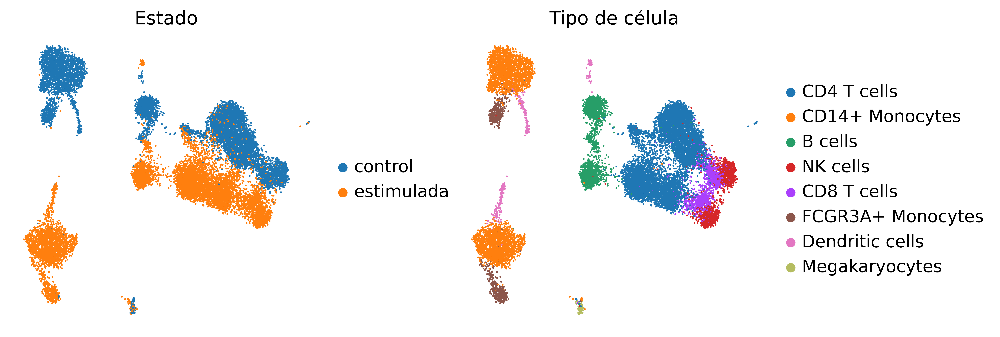

In [65]:
sc.pl.umap(
    adata,
    color=["Estado", "Tipo de célula"],
    frameon=False,
    ncols=2,
    wspace=0.3,
    show=False,
)

plt.savefig(figs_path.joinpath("ivae_scorer_reactome.pdf"), bbox_inches="tight")
plt.savefig(
    figs_path.joinpath("ivae_scorer_reactome.png"), bbox_inches="tight", dpi=300
)

In [66]:
sc.pl.umap(
    adata,
    color=dacs_to_write.pathways.tolist(),
    frameon=False,
    ncols=2,
    wspace=0.3,
    show=False,
)

plt.savefig(figs_path.joinpath("ivae_scorer_reactome_top10.pdf"), bbox_inches="tight")
plt.savefig(
    figs_path.joinpath("ivae_scorer_reactome_top10.png"), bbox_inches="tight", dpi=300
)